In [31]:
#pip install nltk

In [32]:
#pip install spacy

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import re
import seaborn as sns

import nltk

from sklearn.preprocessing import LabelEncoder
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

from sklearn.svm import SVC
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier

from nltk.corpus import stopwords
from nltk.util import ngrams
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from sklearn.feature_extraction.text import CountVectorizer
from collections import defaultdict
from collections import  Counter
plt.style.use('ggplot')


In [2]:
import tensorflow as tf
tf.config.list_logical_devices('GPU')
tf.test.is_gpu_available()

Instructions for updating:
Use `tf.config.list_physical_devices('GPU')` instead.


True

In [3]:
df = pd.read_csv("data_1A.csv", index_col='Unnamed: 0')
df.reset_index(drop=True)
np.random.seed(0) 
df.head()

,text,label
0,The Theory of Everything Review Stephen Hawkin...,Books
1,Computer Networks: A Top - Down Approach About...,Books
2,Sajani Premium Quality Brown Wooden Coat Hange...,Household
3,Bosch Lifestyle MCM3501M 800-Watt Food Process...,Household
4,Secret Wish Women's Navy-Blue Towel Bathrobe (...,Household


In [4]:
df.shape

(12606, 2)

In [5]:
df.tail()

,text,label
12601,Lotus Makeup Ecostay Insta Smooth Perfecting P...,Household
12602,The Subtle Art of Not Giving a F*ck Review “Re...,Books
12603,Elevanto Premium Collection 3/4Th Sleeve Terry...,Household
12604,WD My Passport 4TB Portable External Hard Driv...,Electronics
12605,Storite 16 Foot 3.5 mm Male To 3.5 mm Female J...,Electronics


In [6]:
df.isnull().sum()

text     1
label    0
dtype: int64

In [7]:
df.isnull().values.mean()*100

0.003966365222909726

In [8]:
df = df.fillna(method = 'bfill').fillna(0)
df.isnull().sum()

text     0
label    0
dtype: int64

## **Case Folding**

In [9]:
df['text'] = df['text'].str.casefold()
df

,text,label
0,the theory of everything review stephen hawkin...,Books
1,computer networks: a top - down approach about...,Books
2,sajani premium quality brown wooden coat hange...,Household
3,bosch lifestyle mcm3501m 800-watt food process...,Household
4,secret wish women's navy-blue towel bathrobe (...,Household
...,...,...
12601,lotus makeup ecostay insta smooth perfecting p...,Household
12602,the subtle art of not giving a f*ck review “re...,Books
12603,elevanto premium collection 3/4th sleeve terry...,Household
12604,wd my passport 4tb portable external hard driv...,Electronics


In [10]:
df['label'].value_counts()

Household                 4832
Books                     2951
Electronics               2643
Clothing & Accessories    2180
Name: label, dtype: int64

## **EDA**

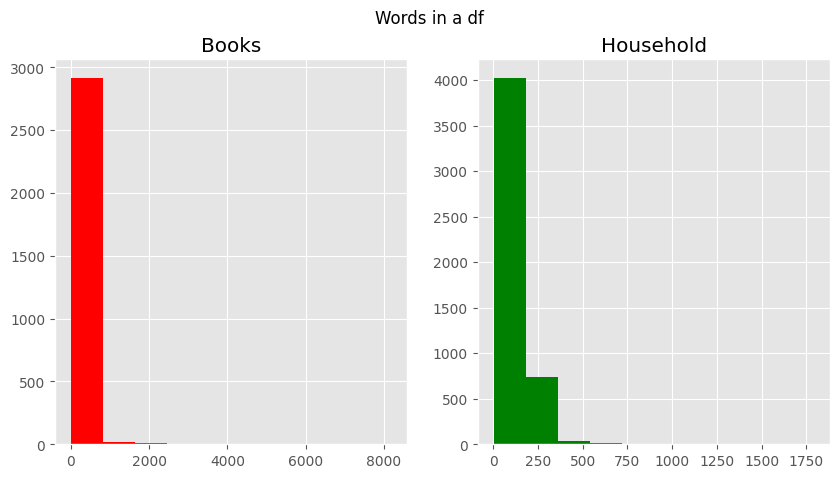

In [11]:
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(10,5))
title_len=df[df['label']=='Books']['text'].str.split().map(lambda x: len(x))
ax1.hist(title_len,color='red')
ax1.set_title('Books')
title_len=df[df['label']=='Household']['text'].str.split().map(lambda x: len(x))
ax2.hist(title_len,color='green')
ax2.set_title('Household')

fig.suptitle('Words in a df')
plt.show()

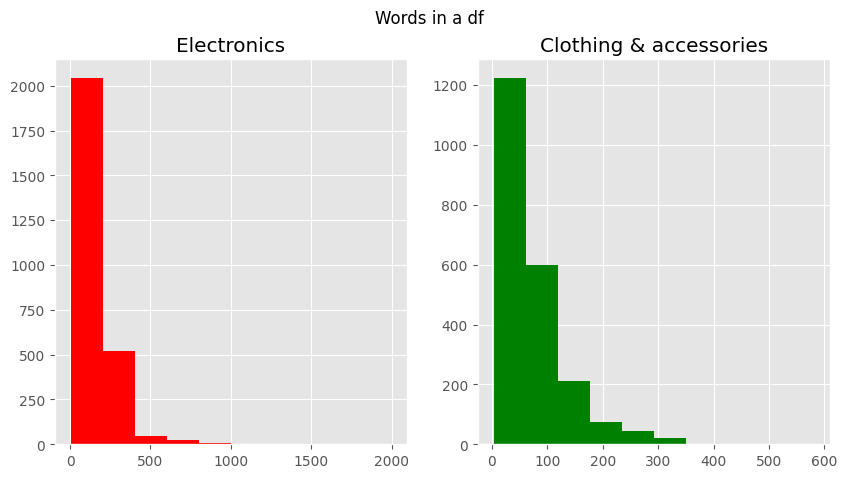

In [12]:
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(10,5))
title_len=df[df['label']=='Electronics']['text'].str.split().map(lambda x: len(x))
ax1.hist(title_len,color='red')
ax1.set_title('Electronics')
title_len=df[df['label']=='Clothing & Accessories']['text'].str.split().map(lambda x: len(x))
ax2.hist(title_len,color='green')
ax2.set_title('Clothing & accessories')

fig.suptitle('Words in a df')
plt.show()

<AxesSubplot:>

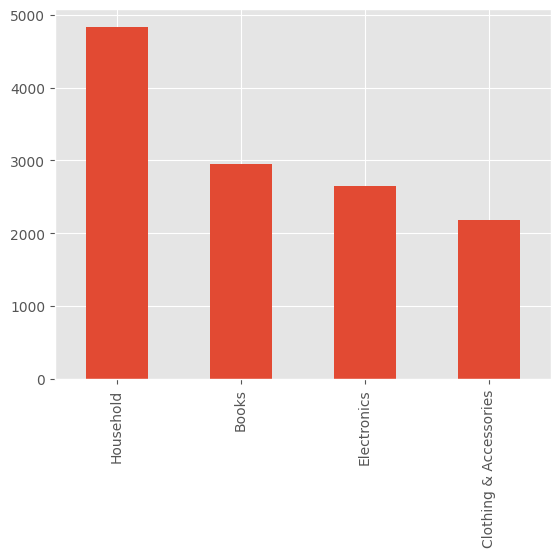

In [13]:
df['label'].value_counts().plot(kind='bar')

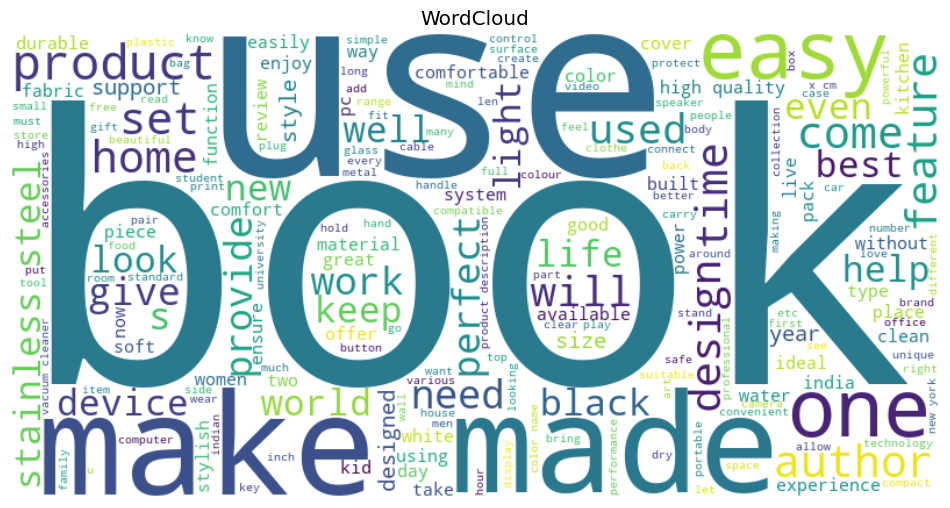

In [ ]:
from wordcloud import WordCloud

wordcloudtext = ' '.join(df['text'])

plt.figure(figsize=(12, 8))
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(wordcloudtext)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title("WordCloud")
plt.show()

In [47]:
df['clean_text'] = [re.sub(r"\d+", "", str(i)) for i in df['text']] #removing numbers
df['clean_text'] = [re.sub(r'\s+', ' ', i) for i in df['clean_text']]
df['clean_text']

0        the theory of everything review stephen hawkin...
1        computer networks: a top - down approach about...
2        sajani premium quality brown wooden coat hange...
3        bosch lifestyle mcmm -watt food processor (bla...
4        secret wish women's navy-blue towel bathrobe (...
                               ...                        
12601    lotus makeup ecostay insta smooth perfecting p...
12602    the subtle art of not giving a f*ck review “re...
12603    elevanto premium collection /th sleeve terry c...
12604    wd my passport tb portable external hard drive...
12605    storite foot . mm male to . mm female jack ext...
Name: clean_text, Length: 12606, dtype: object

## **Removing punctuation**

1st option

In [48]:
import string
def remove_punct(text):
    table=str.maketrans('','',string.punctuation)
    return text.translate(table)

#df['clean_text'] = df['clean_text'].apply(lambda x : remove_punct(x))

2nd option

In [49]:
df['clean_text'] = [re.sub(r'[\W]', ' ', i) for i in df['clean_text']]
df['clean_text']

0        the theory of everything review stephen hawkin...
1        computer networks  a top   down approach about...
2        sajani premium quality brown wooden coat hange...
3        bosch lifestyle mcmm  watt food processor  bla...
4        secret wish women s navy blue towel bathrobe  ...
                               ...                        
12601    lotus makeup ecostay insta smooth perfecting p...
12602    the subtle art of not giving a f ck review  re...
12603    elevanto premium collection  th sleeve terry c...
12604    wd my passport tb portable external hard drive...
12605    storite foot   mm male to   mm female jack ext...
Name: clean_text, Length: 12606, dtype: object

In [50]:
df['tokenized'] = [word_tokenize(i) for i in df['clean_text']]
df['tokenized']

0        [the, theory, of, everything, review, stephen,...
1        [computer, networks, a, top, down, approach, a...
2        [sajani, premium, quality, brown, wooden, coat...
3        [bosch, lifestyle, mcmm, watt, food, processor...
4        [secret, wish, women, s, navy, blue, towel, ba...
                               ...                        
12601    [lotus, makeup, ecostay, insta, smooth, perfec...
12602    [the, subtle, art, of, not, giving, a, f, ck, ...
12603    [elevanto, premium, collection, th, sleeve, te...
12604    [wd, my, passport, tb, portable, external, har...
12605    [storite, foot, mm, male, to, mm, female, jack...
Name: tokenized, Length: 12606, dtype: object

In [51]:
Lemmatizer = WordNetLemmatizer()
for i in range(len(df['tokenized'])):
    # Apply lemmatization to each word in the tokenized list
    df['tokenized'][i] = [Lemmatizer.lemmatize(word) for word in df['tokenized'][i]]
    print(df['tokenized'][i])

['the', 'theory', 'of', 'everything', 'review', 'stephen', 'hawking', 's', 'the', 'theory', 'of', 'everything', 'is', 'a', 'short', 'book', 'that', 'can', 'act', 'a', 'an', 'introduction', 'to', 'the', 'subject', 'of', 'cosmology', 'raised', 'by', 'modern', 'science', 'but', 'the', 'book', 'is', 'only', 'that', 'i', 'preferred', 'his', 'brief', 'history', 'of', 'time', 'to', 'this', 'work', 'because', 'it', 'wa', 'longer', 'more', 'detailed', 'and', 'covered', 'more', 'ground', 'if', 'you', 'are', 'looking', 'for', 'a', 'very', 'basic', 'introduction', 'to', 'the', 'current', 'thinking', 'of', 'astrophysicist', 'this', 'is', 'a', 'good', 'book', 'if', 'you', 'really', 'want', 'to', 'wrestle', 'with', 'the', 'subject', 'at', 'length', 'you', 'should', 'buy', 'a', 'brief', 'history', 'of', 'time', 'or', 'one', 'of', 'paul', 'davy', 'work', 'such', 'a', 'about', 'time', 'if', 'you', 'are', 'looking', 'for', 'a', 'good', 'lecture', 'series', 'on', 'physic', 'richard', 'feynman', 's', 'six'

In [52]:
stopwords_words =set(stopwords.words('english'))
for i in range(len((df['tokenized']))):
    df['tokenized'][i] = [word for word in df['tokenized'][i] if not word in stopwords_words]
    print(df['tokenized'][i])

['theory', 'everything', 'review', 'stephen', 'hawking', 'theory', 'everything', 'short', 'book', 'act', 'introduction', 'subject', 'cosmology', 'raised', 'modern', 'science', 'book', 'preferred', 'brief', 'history', 'time', 'work', 'wa', 'longer', 'detailed', 'covered', 'ground', 'looking', 'basic', 'introduction', 'current', 'thinking', 'astrophysicist', 'good', 'book', 'really', 'want', 'wrestle', 'subject', 'length', 'buy', 'brief', 'history', 'time', 'one', 'paul', 'davy', 'work', 'time', 'looking', 'good', 'lecture', 'series', 'physic', 'richard', 'feynman', 'six', 'easy', 'piece', 'sequel', 'six', 'easy', 'piece', 'really', 'finest', 'genre', 'said', 'book', 'doe', 'good', 'job', 'outlining', 'basic', 'subject', 'matter', 'discussing', 'development', 'big', 'bang', 'theory', 'implication', 'general', 'theory', 'relativity', 'quantum', 'physic', 'formation', 'universe', 'hawking', 'best', 'discussing', 'singularity', 'point', 'universe', 'black', 'hole', 'law', 'physic', 'break',

In [53]:
df['tokenized_spc'] = df['tokenized'].apply(lambda x: ' '.join(x))
df['tokenized_spc']

0        theory everything review stephen hawking theor...
1        computer network top approach author behrouz f...
2        sajani premium quality brown wooden coat hange...
3        bosch lifestyle mcmm watt food processor black...
4        secret wish woman navy blue towel bathrobe fre...
                               ...                        
12601    lotus makeup ecostay insta smooth perfecting p...
12602    subtle art giving f ck review resilience happi...
12603    elevanto premium collection th sleeve terry co...
12604    wd passport tb portable external hard drive ye...
12605    storite foot mm male mm female jack extension ...
Name: tokenized_spc, Length: 12606, dtype: object

## **Data Splitting**

In [54]:
LabelEncoding = LabelEncoder()
df['label'] = LabelEncoder().fit_transform(df['label'])

X = df['tokenized_spc']
y = df['label']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state=42)
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((10084,), (2522,), (10084,), (2522,))

## ****Text Representation****

**TF-IDF**

TF-IDF is for focusing on finding important words without i need to consider the meaning or else, by only their frequency. So it'll be especially useful for information retrieval, classification and summarization.

TF-IDF is based on the occurence and imporance of words within a corpus. Use this where "frequency" matter more than semantic meaning.

On the other hand, GloVe is useful for semantic relationships between words and suited for tasks that require deep understanding word meanings in a certain context. Similarity, analogy, word clustering etc.

In [55]:
tfIdf = TfidfVectorizer()

X_train_tfidf = tfIdf.fit_transform(X_train)
train_tfIDF = pd.DataFrame.sparse.from_spmatrix(X_train_tfidf, columns=tfIdf.get_feature_names_out())
train_tfIDF


,____,____note,__multicoloured_free,_black,_black_,_blue_,_bluestripe_collar_aa,_db,_international,_jg,...,ளடக,வக,வத,வம,வரல,வரவ,①supports,②supports,③supports,④supports
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10079,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
10080,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
10081,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
10082,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [56]:
X_test_tfidf = tfIdf.transform(X_test)
test_tfIDF = pd.DataFrame.sparse.from_spmatrix(X_test_tfidf, columns=tfIdf.get_feature_names_out())
test_tfIDF

,____,____note,__multicoloured_free,_black,_black_,_blue_,_bluestripe_collar_aa,_db,_international,_jg,...,ளடக,வக,வத,வம,வரல,வரவ,①supports,②supports,③supports,④supports
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2517,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2518,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2519,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2520,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Count Vectorizer

A simple method for vectorization, it simply counts how many times each word appears in the text and represents each documennt as vector of word counts.
It's fast and simple but lacking of context and semantic meaning

In [57]:
countVectorizer = CountVectorizer() 

X_train_cv = countVectorizer.fit_transform(X_train) 
train_cv = pd.DataFrame.sparse.from_spmatrix(X_train_cv, columns=countVectorizer.get_feature_names_out())
train_cv

,____,____note,__multicoloured_free,_black,_black_,_blue_,_bluestripe_collar_aa,_db,_international,_jg,...,ளடக,வக,வத,வம,வரல,வரவ,①supports,②supports,③supports,④supports
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10079,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
10080,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
10081,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
10082,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [58]:
X_test_cv = countVectorizer.transform(X_test) 
test_cv = pd.DataFrame.sparse.from_spmatrix(X_test_cv, columns=countVectorizer.get_feature_names_out())
test_cv

,____,____note,__multicoloured_free,_black,_black_,_blue_,_bluestripe_collar_aa,_db,_international,_jg,...,ளடக,வக,வத,வம,வரல,வரவ,①supports,②supports,③supports,④supports
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2517,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2518,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2519,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2520,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


## **Machine Learning Model**

#### **SVM**

In [59]:
svm_tfIdf = make_pipeline(StandardScaler(with_mean=False), SVC(C=1, kernel='rbf', gamma='scale', random_state=0))
svm_cv = make_pipeline(StandardScaler(with_mean=False), SVC(C=1, kernel='rbf', gamma='scale', random_state=0))

In [60]:
svm_tfIdf.fit(train_tfIDF, y_train)
svm_cv.fit(train_cv, y_train)

Pipeline(steps=[('standardscaler', StandardScaler(with_mean=False)),
                ('svc', SVC(C=1, random_state=0))])

In [61]:
svm_tfIdf_pred = svm_tfIdf.predict(test_tfIDF)
svm_cv_pred = svm_cv.predict(test_cv)


### SVM TF-IDF

In [62]:
print(classification_report(y_test, svm_tfIdf_pred, target_names=sorted(y_test.unique().astype(str))))

              precision    recall  f1-score   support

           0       0.74      0.95      0.83       586
           1       0.98      0.83      0.90       466
           2       0.98      0.79      0.87       506
           3       0.91      0.90      0.91       964

    accuracy                           0.88      2522
   macro avg       0.90      0.87      0.88      2522
weighted avg       0.90      0.88      0.88      2522



### SVM CountVectorizer

In [63]:
print(classification_report(y_test, svm_cv_pred, target_names=sorted(y_test.unique().astype(str))))

              precision    recall  f1-score   support

           0       0.83      0.70      0.76       586
           1       0.99      0.79      0.88       466
           2       0.97      0.68      0.80       506
           3       0.70      0.95      0.81       964

    accuracy                           0.81      2522
   macro avg       0.87      0.78      0.81      2522
weighted avg       0.84      0.81      0.81      2522



#### **Random Forest**

In [64]:
rf_tfIdf = RandomForestClassifier(criterion='gini', max_depth=None, random_state=0)
rf_cv = RandomForestClassifier(criterion='gini', max_depth=None, random_state=0)

In [65]:
rf_tfIdf.fit(train_tfIDF, y_train)
rf_cv.fit(train_cv, y_train)

RandomForestClassifier(random_state=0)

In [66]:
rf_tfIdf_pred = rf_tfIdf.predict(test_tfIDF)
rf_cv_pred = rf_cv.predict(test_cv)

 Random Forest Classifier TF-IDF

In [67]:
print(classification_report(y_test, rf_tfIdf_pred, target_names=sorted(y_test.unique().astype(str))))

              precision    recall  f1-score   support

           0       0.95      0.94      0.95       586
           1       0.97      0.94      0.95       466
           2       0.95      0.90      0.92       506
           3       0.92      0.97      0.94       964

    accuracy                           0.94      2522
   macro avg       0.95      0.94      0.94      2522
weighted avg       0.94      0.94      0.94      2522



Random Forest Classifier Count Vectorizer

In [68]:
print(classification_report(y_test, rf_cv_pred, target_names=sorted(y_test.unique().astype(str))))

              precision    recall  f1-score   support

           0       0.94      0.94      0.94       586
           1       0.96      0.95      0.95       466
           2       0.95      0.89      0.92       506
           3       0.92      0.96      0.94       964

    accuracy                           0.94      2522
   macro avg       0.94      0.93      0.94      2522
weighted avg       0.94      0.94      0.94      2522



## **Hypertuned**

SVM - TFIDF

In [69]:
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline

svm_parameters_grid = {
    'svc__C': [1, 10, 100],
    'svc__kernel': ['linear', 'poly', 'rbf'],
    'svc__gamma': ['auto']
}

svm_tfIdf_grid = GridSearchCV(make_pipeline(StandardScaler(with_mean=False), SVC(random_state=0)), param_grid = svm_parameters_grid, scoring='accuracy', cv = 3)
svm_tfIdf_grid.fit(train_tfIDF,y_train)

GridSearchCV(cv=3,
             estimator=Pipeline(steps=[('standardscaler',
                                        StandardScaler(with_mean=False)),
                                       ('svc', SVC(random_state=0))]),
             param_grid={'svc__C': [1, 10, 100], 'svc__gamma': ['auto'],
                         'svc__kernel': ['linear', 'poly', 'rbf']},
             scoring='accuracy')

In [70]:
svm_tfIdf_best_params = svm_tfIdf_grid.best_params_
print(svm_tfIdf_best_params)

{'svc__C': 1, 'svc__gamma': 'auto', 'svc__kernel': 'linear'}


In [71]:
svm_tf_idf_hypertuned = make_pipeline(StandardScaler(with_mean=False), SVC(C=10, kernel='linear', gamma='auto'))
svm_tf_idf_hypertuned.fit(train_tfIDF, y_train)

Pipeline(steps=[('standardscaler', StandardScaler(with_mean=False)),
                ('svc', SVC(C=10, gamma='auto', kernel='linear'))])

In [72]:
svm_tf_idf_hypertuned_pred = svm_tf_idf_hypertuned.predict(test_tfIDF)

In [73]:
print(classification_report(y_test, svm_tf_idf_hypertuned_pred, target_names=sorted(y_test.unique().astype(str))))

              precision    recall  f1-score   support

           0       0.83      0.95      0.89       586
           1       0.95      0.96      0.95       466
           2       0.92      0.89      0.90       506
           3       0.95      0.87      0.91       964

    accuracy                           0.91      2522
   macro avg       0.91      0.92      0.91      2522
weighted avg       0.92      0.91      0.91      2522



performa dari model ini berhasil kita tingkatkan setelah kita melakukan hyperparameter tuning dengan menggunakan GridSearchCV dan tuning

SVM - Cv

In [75]:
svm_parameters_grid = {
    'svc__C': [1, 10, 100],
    'svc__kernel': ['linear', 'poly', 'rbf'],
    'svc__gamma': ['auto']
}

svm_cv_grid = GridSearchCV(make_pipeline(StandardScaler(with_mean=False), SVC(random_state=0)), param_grid = svm_parameters_grid, scoring='accuracy', cv = 3)
svm_cv_grid.fit(train_cv,y_train)

GridSearchCV(cv=3,
             estimator=Pipeline(steps=[('standardscaler',
                                        StandardScaler(with_mean=False)),
                                       ('svc', SVC(random_state=0))]),
             param_grid={'svc__C': [1, 10, 100], 'svc__gamma': ['auto'],
                         'svc__kernel': ['linear', 'poly', 'rbf']},
             scoring='accuracy')

In [76]:
svm_cv_best_params = svm_cv_grid.best_params_
print(svm_cv_best_params)

{'svc__C': 1, 'svc__gamma': 'auto', 'svc__kernel': 'linear'}


In [77]:
svm_cv_hypertuned = make_pipeline(StandardScaler(with_mean=False), SVC(C=1, kernel='linear', gamma='auto'))
svm_cv_hypertuned.fit(train_cv, y_train)

Pipeline(steps=[('standardscaler', StandardScaler(with_mean=False)),
                ('svc', SVC(C=1, gamma='auto', kernel='linear'))])

In [78]:
svm_cv_hypertuned_pred = svm_cv_hypertuned.predict(test_cv)

In [79]:
print(classification_report(y_test, svm_cv_hypertuned_pred, target_names=sorted(y_test.unique().astype(str))))

              precision    recall  f1-score   support

           0       0.80      0.92      0.86       586
           1       0.95      0.91      0.93       466
           2       0.91      0.88      0.90       506
           3       0.94      0.88      0.91       964

    accuracy                           0.90      2522
   macro avg       0.90      0.90      0.90      2522
weighted avg       0.90      0.90      0.90      2522



## Random Forest TF-idf

In [80]:
rf_parameters = {
    'criterion': ['gini', 'entropy', 'log_loss'],
    'max_depth': [2,4,6,8]
}

rf_tfIDF_grid = GridSearchCV(
    RandomForestClassifier(random_state=0),
    param_grid=rf_parameters,
    scoring='accuracy',
    cv=3
)

rf_tfIDF_grid.fit(train_tfIDF, y_train)

c:\Users\srbol\anaconda3\envs\deep_learning\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
12 fits failed out of a total of 36.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
12 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\srbol\anaconda3\envs\deep_learning\lib\site-packages\sklearn\model_selection\_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\srbol\anaconda3\envs\deep_learning\lib\site-packages\sklearn\ensemble\_forest.py", line 467, in fit
    for i, t in enumerate(trees)
  File "c:\Users\srbol\anaconda3\envs\deep_learning\lib\site-packages\joblib\parallel.py", line 1863, in __call__
    retu

GridSearchCV(cv=3, estimator=RandomForestClassifier(random_state=0),
             param_grid={'criterion': ['gini', 'entropy', 'log_loss'],
                         'max_depth': [2, 4, 6, 8]},
             scoring='accuracy')

In [82]:
rf_tfIdf_best_params = rf_tfIDF_grid.best_params_
print(rf_tfIdf_best_params)

{'criterion': 'entropy', 'max_depth': 8}


In [83]:
rf_tfIdf_hypertuned = RandomForestClassifier(criterion='entropy', max_depth=8, random_state=0)
rf_tfIdf_hypertuned.fit(train_tfIDF, y_train)

RandomForestClassifier(criterion='entropy', max_depth=8, random_state=0)

In [84]:
rf_tf_Idf_hypertuned_pred = rf_tfIdf_hypertuned.predict(test_tfIDF)

In [85]:
print(classification_report(y_test, rf_tf_Idf_hypertuned_pred, target_names=sorted(y_test.unique().astype(str))))

              precision    recall  f1-score   support

           0       0.98      0.50      0.66       586
           1       1.00      0.16      0.27       466
           2       0.95      0.38      0.54       506
           3       0.49      0.99      0.66       964

    accuracy                           0.60      2522
   macro avg       0.86      0.51      0.53      2522
weighted avg       0.79      0.60      0.56      2522



In [98]:
rf_tfIdf_hypertuned_none = RandomForestClassifier(criterion='entropy', max_depth=None, random_state=0)
rf_tfIdf_hypertuned_none.fit(train_cv, y_train)

rf_tfIdf_hypertuned_none_pred = rf_tfIdf_hypertuned_none.predict(test_cv)

print(classification_report(y_test, rf_tfIdf_hypertuned_none_pred, target_names=sorted(y_test.unique().astype(str))))

              precision    recall  f1-score   support

           0       0.94      0.95      0.94       586
           1       0.96      0.93      0.94       466
           2       0.95      0.89      0.92       506
           3       0.91      0.96      0.94       964

    accuracy                           0.94      2522
   macro avg       0.94      0.93      0.94      2522
weighted avg       0.94      0.94      0.94      2522



Random Forest CV

In [ ]:
rf_parameters = {
    'criterion': ['gini', 'entropy', 'log_loss'],
    'max_depth': [2,4,6,8]
}

rf_cv_grid = GridSearchCV(
    RandomForestClassifier(random_state=0),
    param_grid=rf_parameters,
    scoring='accuracy',
    cv=5
)

rf_cv_grid.fit(train_cv, y_train)

c:\Users\srbol\anaconda3\envs\deep_learning\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
20 fits failed out of a total of 60.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
20 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\srbol\anaconda3\envs\deep_learning\lib\site-packages\sklearn\model_selection\_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\srbol\anaconda3\envs\deep_learning\lib\site-packages\sklearn\ensemble\_forest.py", line 467, in fit
    for i, t in enumerate(trees)
  File "c:\Users\srbol\anaconda3\envs\deep_learning\lib\site-packages\joblib\parallel.py", line 1863, in __call__
    retu

GridSearchCV(cv=5, estimator=RandomForestClassifier(random_state=0),
             param_grid={'criterion': ['gini', 'entropy', 'log_loss'],
                         'max_depth': [2, 4, 6, 8]},
             scoring='accuracy')

In [87]:
rf_cv_best_params = rf_cv_grid.best_params_
print(rf_cv_best_params)

{'criterion': 'entropy', 'max_depth': 8}


In [ ]:
rf_cv_hypertuned_max8 = RandomForestClassifier(criterion='entropy', max_depth=8, random_state=0)
rf_cv_hypertuned_max8.fit(train_cv, y_train)

RandomForestClassifier(criterion='entropy', max_depth=8, random_state=0)

In [ ]:
rf_cv_hypertuned_pred = rf_cv_hypertuned_max8.predict(test_cv)

In [95]:
print(classification_report(y_test, rf_cv_hypertuned_pred, target_names=sorted(y_test.unique().astype(str))))

              precision    recall  f1-score   support

           0       0.98      0.50      0.66       586
           1       1.00      0.20      0.33       466
           2       0.95      0.37      0.53       506
           3       0.50      0.99      0.66       964

    accuracy                           0.61      2522
   macro avg       0.86      0.51      0.55      2522
weighted avg       0.79      0.61      0.57      2522



In [97]:
rf_cv_hypertuned_none = RandomForestClassifier(criterion='entropy', max_depth=None, random_state=0)
rf_cv_hypertuned_none.fit(train_cv, y_train)

rf_cv_hypertuned_none_pred = rf_cv_hypertuned_none.predict(test_cv)

print(classification_report(y_test, rf_cv_hypertuned_none_pred, target_names=sorted(y_test.unique().astype(str))))

              precision    recall  f1-score   support

           0       0.94      0.95      0.94       586
           1       0.96      0.93      0.94       466
           2       0.95      0.89      0.92       506
           3       0.91      0.96      0.94       964

    accuracy                           0.94      2522
   macro avg       0.94      0.93      0.94      2522
weighted avg       0.94      0.94      0.94      2522



Pada semua yang ada di RandomForest tersebut, semua mengalami penurunan pada performanya dikarenakan saya melakukan pembatasan pada max_depth. Dengan begitu, tingkat kompleksitas dan depth dari treenya terbatas, itu menjadi alasan mengapa ketika dipakai "None", yang berarti depthnya tidak dibatasi bisa menjadi jauh lebih bagus. 